# <center>Laboratorium 12<br>Metody Numeryczne</center>    


Instrukcja:  
Na zajęciach należy wykonać poniższe zadania, a następnie sporządzić sprawozdanie zawierające odpowiedzi z komentarzami.

**Cel zajęć:** Celem zajęć jest zapoznanie się z numerycznymi metodami rozwiązywania równań różniczkowych
zwyczajnych. Będziemy rozpatrywać równania różniczkowe postaci
$$\dot{x}(t) = f(x(t), t)$$
gdzie:

$x(t) \in \mathbb{R}^n$,

$t \ge 0$ 


z warunkiem początkowym $x(0) = x0$

Jest to tak zwany problem początkowy (problem Cauchy’ego) dla równań różniczkowych zwyczajnych.

In [2]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.integrate import solve_ivp
import main

**Zadanie 1.**  
Zaimplementuj metodę *solve_euler* z main.py 


***Zadanie 2.*** 

Dla 3 różnych kroków czasowych (1e1, 1e-2, 1e-5) korzystając z metody z zadania 1 rozwiąż równanie 

$
\dot{x}(t)= \frac{x+t}{x-t}
$ 

$x(0)=1$ (równanie to posiada rozwiązanie dokładne: 
$x(t)=t+\sqrt{1+2t^2}$).

Narysuj wykres podanego rozwiązania dokładnego oraz uzyskanych rozwiązań numerycznych.


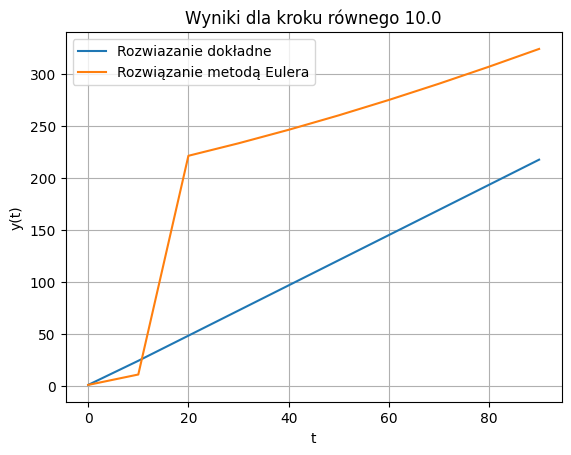

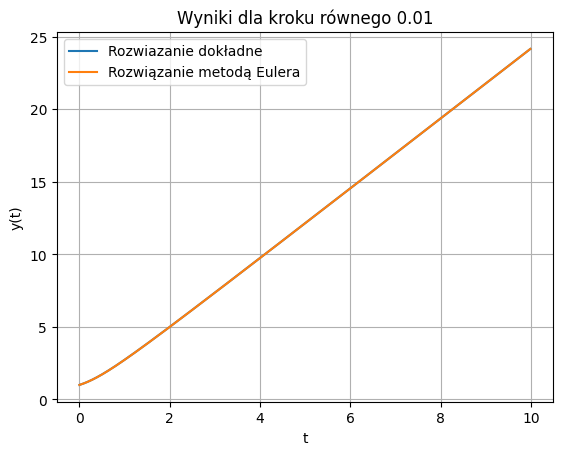

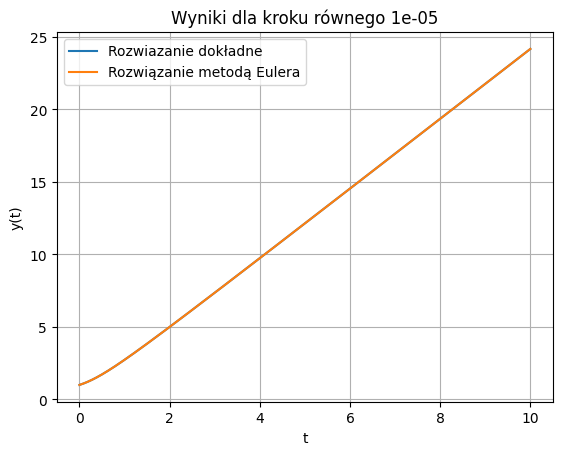

In [3]:
fun = lambda t, x: (x + t) / (x - t)

time_steps = [1e1, 1e-2, 1e-5]

for i in time_steps:
    t = np.arange(0., 10., i) if i != 1e1 else np.arange(0., 100., i)
    result = main.solve_euler(fun, t, np.array([1]))
    exac = lambda t: t + np.sqrt(1 + 2 * t**2)

    plt.plot(t, exac(t), t, result)
    plt.grid()
    plt.title(f"Wyniki dla kroku równego {i}")
    plt.xlabel("t")
    plt.ylabel("y(t)")
    plt.legend(["Rozwiazanie dokładne", "Rozwiązanie metodą Eulera"])
    plt.show()






***Zadanie 3.*** 

Dla 3 różnych kroków czasowych (1e1, 1e-2, 1e-5):

1. Rozwiąż układ równań różniczkowych: 
$$
\begin{array}{l}
\dot{x_1}(t)={x_3}(t)\\
\dot{x_2}(t)={x_4}(t)\\
\dot{x_3}(t)=-\frac{x_1(t)}{{(x_1(t)^2+x_2(t)^2)}^{\frac{3}{2}}}\\
\dot{x_4}(t)=-\frac{x_2(t)}{{(x_1(t)^2+x_2(t)^2)}^{\frac{3}{2}}}
\end{array}
$$
      
z warunkiem początkowym $x(0)=[1,0,0,1]^T$.
    
Dla takiego warunku początkowego układ ten ma rozwiązanie szczególne 
$$
x(t)=\left[\begin{matrix}
cos(t)\\
sin(t)\\
-sin(t)\\
cos(t)
\end{matrix}\right].
$$  

2. Narysuj wykres podanego rozwiązania szczegółowego oraz uzyskanych rozwiązań numerycznych.
3. Sprawdź po jakim czasie t rozwiązania numeryczne przestaną dawać zadowalające wyniki. W tym celu zbadaj błąd między rozwiązania numerycznego względem szczagólnego

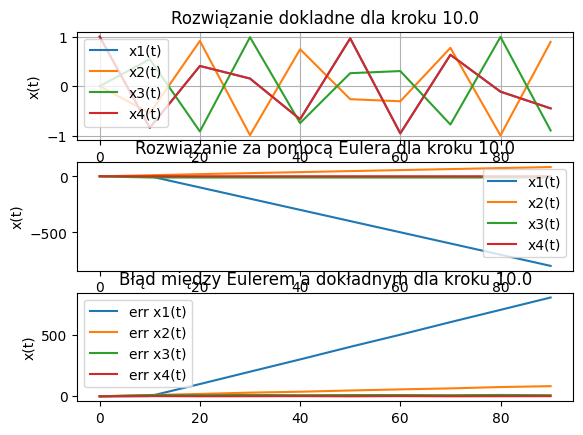

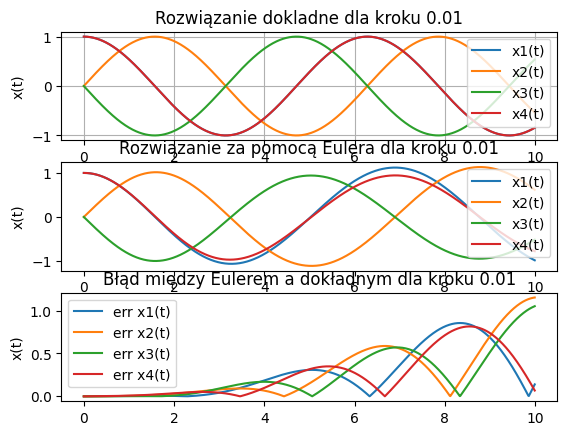

C:\Users\Tomek\AppData\Roaming\Python\Python310\site-packages\IPython\core\pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


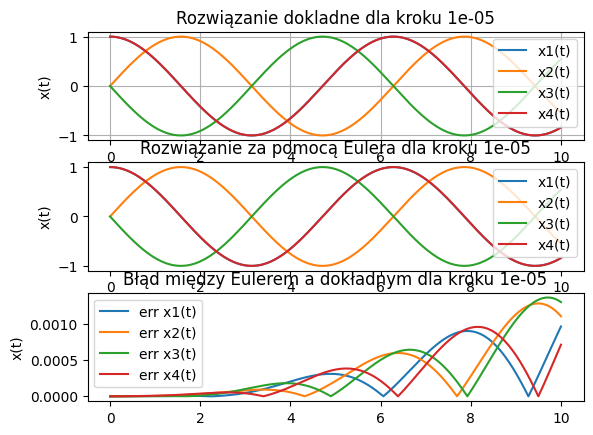

In [4]:
# exact_solution = np.ndarray([np.cos(t), np.sin(t), -np.sin(t), np.cos(t)])
funs = np.array([lambda t,y: y[2],lambda t,y: y[3],lambda t,y: -1*y[0]/(y[0]**2+y[1]**2)**(3/2),lambda t,y: -1*y[1]/(y[0]**2+y[1]**2)**(3/2)])

x0 = np.array([1, 0, 0, 1])

for i in time_steps:
    t = np.arange(0., 10., i) if i != 1e1 else np.arange(0., 100., i)
    x = main.solve_euler(funs, t, x0)

    plt.subplot(3,1,1)
    plt.plot(t, np.cos(t), t, np.sin(t))
    plt.plot(t, -np.sin(t), t, np.cos(t))
    plt.grid()
    plt.title(f'Rozwiązanie dokladne dla kroku {i}')
    plt.ylabel('x(t)')
    plt.legend(["x1(t)", "x2(t)", "x3(t)", "x4(t)"])

    plt.subplot(3,1,2)
    plt.plot(t, x[:,0], t, x[:,1])
    plt.plot(t, x[:,2], t, x[:,3])
    plt.title(f'Rozwiązanie za pomocą Eulera dla kroku {i}')
    plt.legend(["x1(t)", "x2(t)", "x3(t)", "x4(t)"])
    plt.ylabel('x(t)')

    error_0 = np.abs(np.cos(t) - x[:,0])
    error_1 = np.abs(np.sin(t) - x[:,1])
    error_2 = np.abs(-np.sin(t) - x[:,2])
    error_3 = np.abs(np.cos(t) - x[:,3])

    plt.subplot(3,1,3)
    plt.plot(t, error_0, t, error_1)
    plt.plot(t, error_2, t, error_3)
    plt.title(f'Błąd między Eulerem a dokładnym dla kroku {i}')
    plt.legend(["err x1(t)", "err x2(t)", "err x3(t)", "err x4(t)"])
    plt.ylabel('x(t)')

    plt.show()


***Zadanie 4.*** 

Za pomocą funkcji solve_ivp przy wykorzystaniu dwóch metod RK45 i RK23 rozwiąż układ równań z poprzedniego zadania i porównaj wyniki dla takiego samego przedziału czasu.

Sprawdź ile razy każda z metod obliczała równanie prawej strony (parametr nfev). Odnieś to do analogicznej liczby z metody z poprzedniego zadania

Dla wybranej metody zbadaj wpływ parametru rtol na rozwiązanie

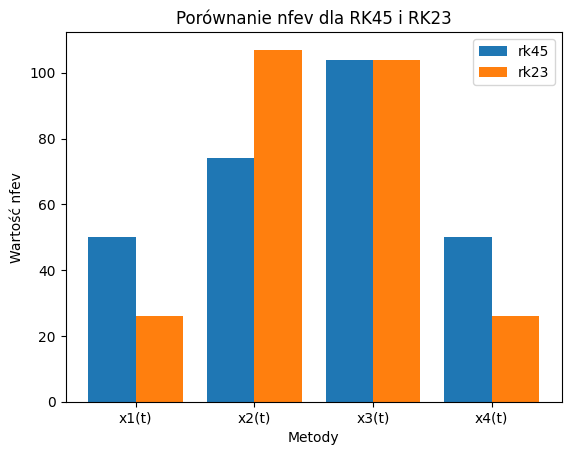

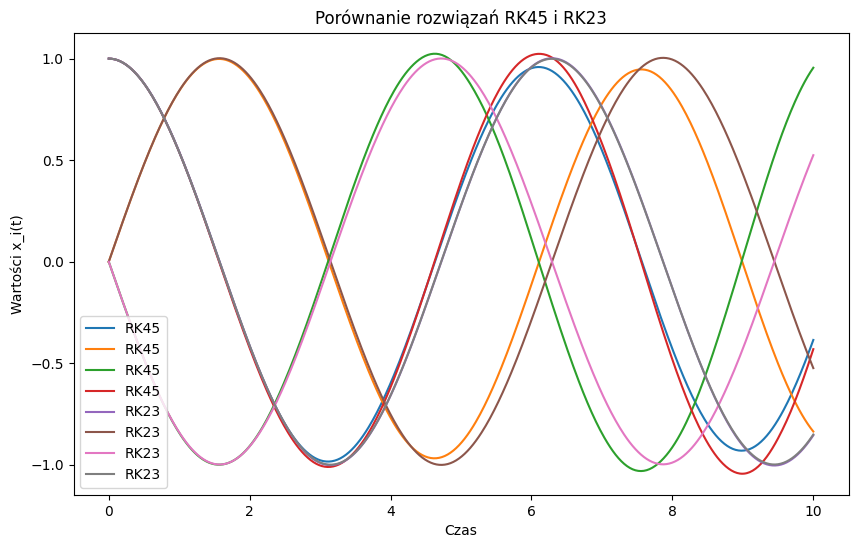

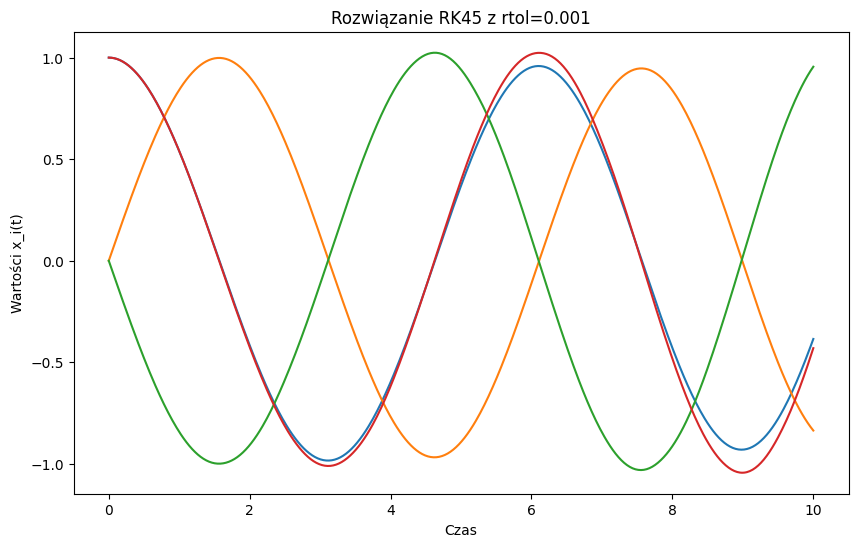

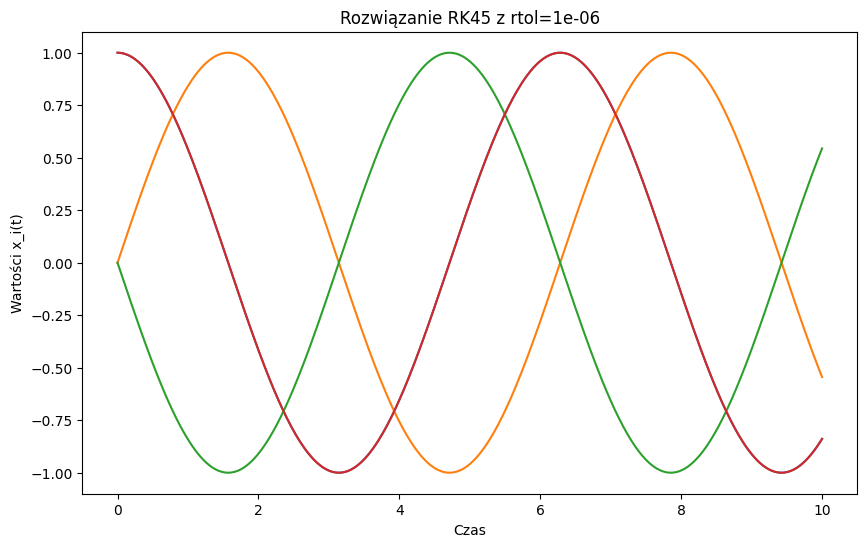

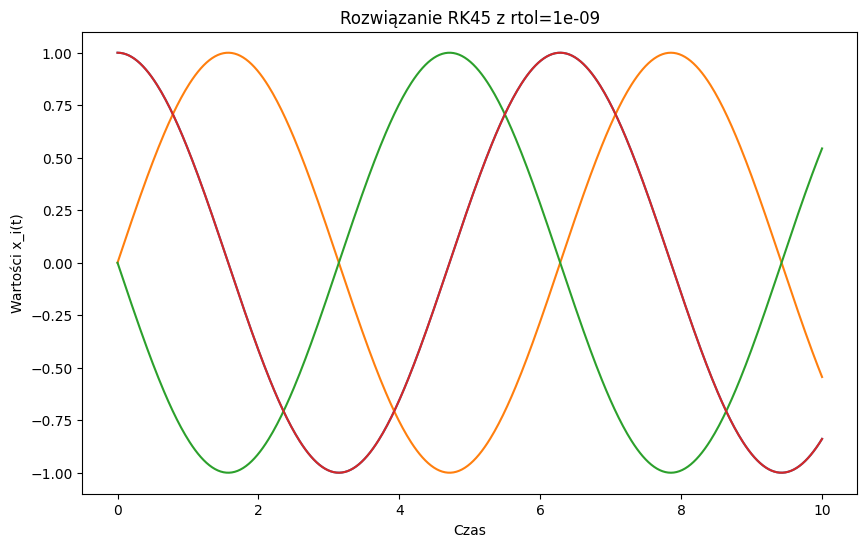

In [5]:
rk45 = []
rk45_rtol = []
rk23 = []
time = [0, 10]
error_norm_rtol = []

for i in funs:
    rk45.append(solve_ivp(i, time, x0, method='RK45'))
    rk45_rtol.append(solve_ivp(i, time, x0, method='RK45', rtol=True))
    rk23.append(solve_ivp(i, time, x0, method='RK23'))

rk45_nfev = [x.nfev for x in rk45]
rk23_nfev = [x.nfev for x in rk23]

labels = ['x1(t)', 'x2(t)', 'x3(t)', 'x4(t)']
X_axis = np.arange(len(labels))
plt.bar(X_axis - 0.2, rk45_nfev, 0.4, label = 'rk45')
plt.bar(X_axis + 0.2, rk23_nfev, 0.4, label = 'rk23')
plt.xticks(X_axis, labels) 
plt.xlabel("Metody") 
plt.ylabel("Wartość nfev") 
plt.title("Porównanie nfev dla RK45 i RK23") 
plt.legend() 
plt.show() 

def rhs(t, x):
    x1_dot = x[2]
    x2_dot = x[3]
    x3_dot = -x[0] / (x[0]**2 + x[1]**2)**(3/2)
    x4_dot = -x[1] / (x[0]**2 + x[1]**2)**(3/2)
    return [x1_dot, x2_dot, x3_dot, x4_dot]

initial_conditions = [1, 0, 0, 1]

t_span = (0, 10)

sol_rk45 = solve_ivp(rhs, t_span, initial_conditions, method='RK45', dense_output=True)

sol_rk23 = solve_ivp(rhs, t_span, initial_conditions, method='RK23', dense_output=True)

t_eval = np.linspace(t_span[0], t_span[1], 500)
x_rk45 = sol_rk45.sol(t_eval)
x_rk23 = sol_rk23.sol(t_eval)

plt.figure(figsize=(10, 6))
plt.plot(t_eval, x_rk45.T, label='RK45')
plt.plot(t_eval, x_rk23.T, label='RK23')
plt.title('Porównanie rozwiązań RK45 i RK23')
plt.xlabel('Czas')
plt.ylabel('Wartości x_i(t)')
plt.legend()
plt.show()

nfev_rk45 = sol_rk45.nfev
nfev_rk23 = sol_rk23.nfev

# print(f"Liczba obliczeń równań prawej strony dla RK45: {nfev_rk45}")
# print(f"Liczba obliczeń równań prawej strony dla RK23: {nfev_rk23}")

rtol_values = [1e-3, 1e-6, 1e-9]
for rtol in rtol_values:
    sol_rk45_rtol = solve_ivp(rhs, t_span, initial_conditions, method='RK45', dense_output=True, rtol=rtol)
    x_rk45_rtol = sol_rk45_rtol.sol(t_eval)
    
    plt.figure(figsize=(10, 6))
    plt.plot(t_eval, x_rk45_rtol.T)
    plt.title(f'Rozwiązanie RK45 z rtol={rtol}')
    plt.xlabel('Czas')
    plt.ylabel('Wartości x_i(t)')
    plt.show()


***Zadanie 5.*** 

Orbita Arenstorfa. Jest to przykład z astronomii opisujący zredukowany problem trzech ciał. Rozważa się dwa ciała o masach $\mu$ i $\mu'=1-\mu$, poruszające się w ruchu kołowym na jednej płaszczyźnie oraz ciało o pomijalnej masie poruszające się między nimi w tej samej płaszczyźnie. Dany jest układ równań różniczkowych:
$$
\begin{array}{l}
\dot{x_1}(t)={x_2}(t)\\
\dot{x_2}(t)={x_1}(t)+2x_4(t)-\mu'\frac{x_1+\mu}{D_1}-\mu\frac{x_1-\mu'}{D_2}\\
\dot{x_3}(t)=x_4(t)\\
\dot{x_4}(t)=x_3(t)-2x_2(t)-\mu'\frac{x_3(t)}{D_1}
-\mu\frac{x_3(t)}{D_2}\end{array}.
$$

gdzie
$$
\begin{array}{l}
D_1=((x_1(t)+\mu)^2+{x_3}^2(t))^\frac{3}{2}\\
D_2=((x_1(t)-\mu')^2+{x_3}^2(t))^\frac{3}{2}\\
\mu=0.012277471\end{array}.
$$

Zmienne $x_1$ i $x_3$ odpowiadają za współrzędne na płaszczyźnie trzeciego ciała zaś $x_2$ i $x_4$
są odpowiednio prędkościami. Warto zwrócić uwagę, że zarówno czas jak i masa zostały
w równaniach przeskalowane, i nie mają bezpośredniej interpretacji fizycznej, należy je
traktować jako zmienne bezwymiarowe. Dla pewnych warunków początkowych i czasu
symulacji
$$
\begin{array}{l}
x_1(0) = 0.994\\
x_2(0) = 0\\
x_3(0) = 0\\
x_4(0) = − 2.00158510637908252240537862224\\
T = 17.0652165601579625588917206249.\end{array}
$$
dokładne rozwiązanie tych równań jest okresowe ($x(0)=x(T)$).

Funkcję obliczającą pochodne zaimplementuj w main.py

Narysuj wykres uzyskanych rozwiązań numerycznych.

[0.994, 0.994, 0.9939998737825382, 0.9939996213552162, 0.9939992427358572, 0.9939987379524992, 0.9939981070433855, 0.9939973500569513, 0.993996467051806, 0.9939954580967125, 0.9939943232705634, 0.9939930626623519, 0.9939916763711414, 0.9939901645060296, 0.9939885271861104, 0.9939867645404313, 0.9939848767079486, 0.9939828638374776, 0.9939807260876412, 0.9939784636268137, 0.9939760766330623, 0.9939735652940845, 0.9939709298071435, 0.993968170378999, 0.9939652872258362, 0.9939622805731911, 0.9939591506558731, 0.9939558977178845, 0.9939525220123372, 0.9939490238013668, 0.993945403356044, 0.9939416609562827, 0.9939377968907466, 0.9939338114567525, 0.9939297049601715, 0.9939254777153275, 0.9939211300448938, 0.9939166622797875, 0.9939120747590613, 0.9939073678297936, 0.9939025418469769, 0.9938975971734033, 0.9938925341795496, 0.9938873532434591, 0.9938820547506234, 0.9938766390938608, 0.993871106673195, 0.9938654578957309, 0.9938596931755301, 0.9938538129334845, 0.9938478175971891, 0.9938417

C:\Users\Tomek\AppData\Local\Temp\ipykernel_14412\994235211.py:31: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()


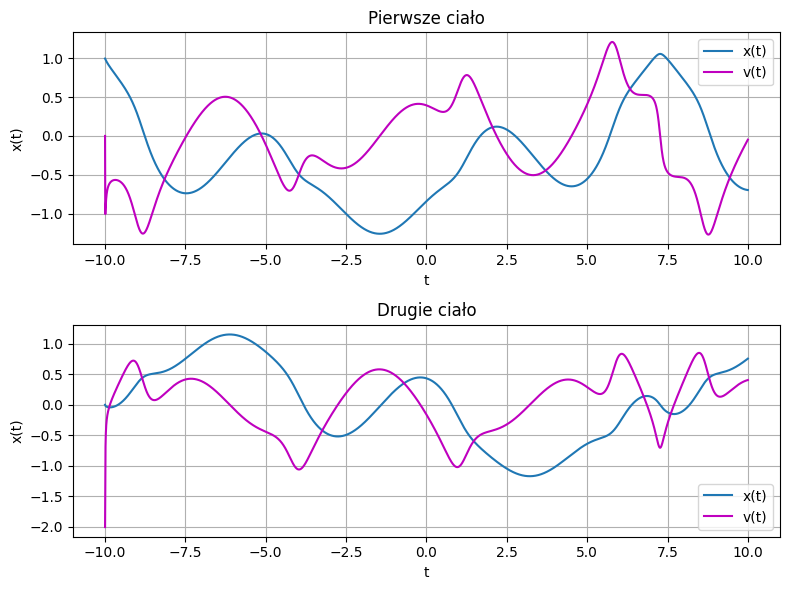

Text(0, 0.5, 'x2(t)')

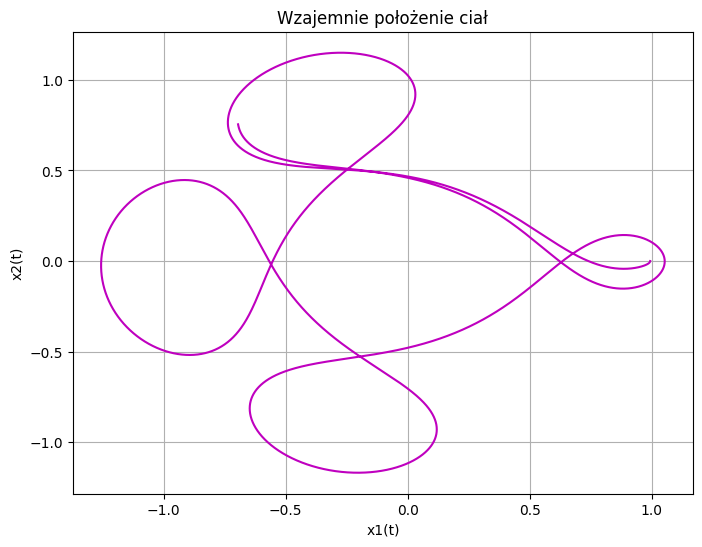

In [9]:
from main import arenstorf

x0 = np.array([0.994, 0, 0, -2.00158510637908252240537862224])
T = 17.0652165601579625588917206249
t = np.linspace(-10, 10, 10000000)
x = main.solve_euler(arenstorf, t, x0)
xt_1 = [i[0] for i in x]
xt_2 = [i[2] for i in x]
vt_1 = [i[1] for i in x]
vt_2 = [i[3] for i in x]
print(xt_1)

plt.figure(num=None, figsize=(8, 6))

plt.subplot(2,1,1)
plt.plot(t, xt_1, t, vt_1, "m")
plt.title("Pierwsze ciało")
plt.grid()
plt.legend(["x(t)", "v(t)"])
plt.xlabel("t")
plt.ylabel("x(t)")

plt.subplot(2,1,2)
plt.plot(t, xt_2, t, vt_2, "m")
plt.title("Drugie ciało")
plt.grid()
plt.legend(["x(t)", "v(t)"])
plt.xlabel("t")
plt.ylabel("x(t)")

plt.tight_layout()
plt.show()

plt.figure(num=None, figsize=(8, 6))
plt.plot(xt_1, xt_2, "m")
plt.title("Wzajemnie położenie ciał")
plt.grid()
plt.xlabel("x1(t)")
plt.ylabel("x2(t)")


**Bibliografia**

1. J. C. Butcher. Numerical Methods for Ordinary Differential Equations. John Wiley and Sons, Ltd., 2003.
2. Z. Fortuna, B. Macukow, and J. Wąsowski. Metody numeryczne. WNT Warszawa, 1982.
3. E. Hairer, S.P. Nørsett, and G. Wanner. Solving Ordinary Differential Equations: I Nonstiff problems. Springer, 2 edition, 2000.
4. W. Mitkowski. Równania macierzowe i ich zastosowania. Wydawnictwa AGH, Kraków,2 edition, 2007.
5. A. Ralston. Wstęp do analizy numerycznej. PWN, Warszawa, 1965.
6. L. F. Shampine, I. Gladwell, and S. Thompson. Solving ODEs with MATLAB. Cambridge University Press, 2003.
7. Stoer, J., Burlirsch, R., 1980: Wstêp do metod numerycznych, tom 2. PWN Warszawa.
